In [1]:
import pandas as pd
from sklearn.cluster import MiniBatchKMeans
import pickle
import numpy as np
from wordcloud import WordCloud, STOPWORDS
import gc
import time
import matplotlib.pyplot as plt
from sklearn.tree import DecisionTreeClassifier, plot_tree

In [2]:
df_recipes_one_hot = pd.read_pickle('../kmeans/recipe_encoded_df.pkl')

# Train models

In [3]:
MIN_CLUSTERS = 2
MAX_CLUSTERS = 30
STEP = 2
MAX_ITER = 10000
ROOT_FOLDER = '../models'

In [4]:
model_locs = []
for n_clusters in range(MIN_CLUSTERS, MAX_CLUSTERS, STEP):
    print(f"Training {n_clusters} clusters")
    kmeans = MiniBatchKMeans(n_clusters=n_clusters, random_state=0, max_iter=MAX_ITER, verbose=1)
    for i in range(0, df_recipes_one_hot.shape[0], 10000):
        kmeans = kmeans.partial_fit(df_recipes_one_hot[i:i+10000])
    filename = f'{ROOT_FOLDER}/trained_kmeans_{n_clusters}_{time.strftime("%Y%m%d-%H%M%S")}.pkl'
    pickle.dump(kmeans, open(filename, 'wb'))
    model_locs.append(filename)
    del kmeans
    gc.collect()

Training 2 clusters
Training 4 clusters
Training 6 clusters
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 2 cluster centers.
Training 8 clusters
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 1 cluster centers.
[MiniBatchKMeans] Reassigning 1 cluster centers.
Training 10 clusters
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 2 cluster centers.
Training 12 clusters
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 1 cluster centers.
[MiniBatchKMeans] Reassigning 2 cluster centers.
Training 14 clusters
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 2 cluster centers.
Training 16 clusters
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 2 cluster centers.
[MiniBatchKMeans] Reassigning 1 cluster centers.
[MiniBatchKMeans] Reassigning 2 cluster centers.
Training 18 clusters
[MiniBatchKMeans] Reassigning 1

In [5]:
model_locs

['../models/trained_kmeans_2_20221023-221709.pkl',
 '../models/trained_kmeans_4_20221023-221734.pkl',
 '../models/trained_kmeans_6_20221023-221759.pkl',
 '../models/trained_kmeans_8_20221023-221824.pkl',
 '../models/trained_kmeans_10_20221023-221848.pkl',
 '../models/trained_kmeans_12_20221023-221914.pkl',
 '../models/trained_kmeans_14_20221023-221939.pkl',
 '../models/trained_kmeans_16_20221023-222004.pkl',
 '../models/trained_kmeans_18_20221023-222029.pkl',
 '../models/trained_kmeans_20_20221023-222054.pkl',
 '../models/trained_kmeans_22_20221023-222119.pkl',
 '../models/trained_kmeans_24_20221023-222145.pkl',
 '../models/trained_kmeans_26_20221023-222210.pkl',
 '../models/trained_kmeans_28_20221023-222235.pkl']

# Evaluate models

In [6]:
random_sample_df = df_recipes_one_hot.sample(n=5000, random_state=0)

In [7]:
for filename in model_locs: 
    kmeans = pickle.load(open(filename, 'rb'))
    print(filename, kmeans.score(random_sample_df))

../models/trained_kmeans_2_20221023-221709.pkl -39922.119148492915
../models/trained_kmeans_4_20221023-221734.pkl -38521.17818291108
../models/trained_kmeans_6_20221023-221759.pkl -38453.2197463841
../models/trained_kmeans_8_20221023-221824.pkl -37671.63128038059
../models/trained_kmeans_10_20221023-221848.pkl -37398.06822703121
../models/trained_kmeans_12_20221023-221914.pkl -37118.586570997926
../models/trained_kmeans_14_20221023-221939.pkl -36805.0097579555
../models/trained_kmeans_16_20221023-222004.pkl -36588.77335230791
../models/trained_kmeans_18_20221023-222029.pkl -36197.53313432412
../models/trained_kmeans_20_20221023-222054.pkl -35878.7811782953
../models/trained_kmeans_22_20221023-222119.pkl -36026.52150660439
../models/trained_kmeans_24_20221023-222145.pkl -35889.38761640841
../models/trained_kmeans_26_20221023-222210.pkl -35739.491472315975
../models/trained_kmeans_28_20221023-222235.pkl -35460.15426735298


# Visualize content of groups

In [8]:
recipe_df = pd.read_csv('../data/RAW_recipes.csv', index_col='id')

In [9]:
recipe_df['str_name'] = recipe_df['name'].astype(str)

In [10]:
def get_labeled_recipes(filename: str):
    kmeans = pickle.load(open(filename, 'rb'))
    labels = []
    for i in range(0, df_recipes_one_hot.shape[0], 10000):
       labels.extend(kmeans.predict(df_recipes_one_hot[i:i+10000]))
    
    df_recipes_with_labels = df_recipes_one_hot.copy()
    df_recipes_with_labels["label"] = labels
    
    labeled_recipes_df = recipe_df.join(df_recipes_with_labels[["label"]])
    labels = np.unique(labeled_recipes_df["label"])
        
    return labeled_recipes_df, labels

In [11]:
def create_wordclouds(df, labels):
    n_labels = max(labels) + 1
    wordclouds = []
    for label in labels:
        tmp_df = df[df["label"] == label]
        names = np.unique(tmp_df["str_name"])
        wordcloud = WordCloud(stopwords=STOPWORDS).generate(" ".join(names))
        wordclouds.append(wordcloud)
       
    plt.figure()
    rows = len(labels)//5
    if len(labels) % 5 != 0:
        rows += 1
        
    figs, axs = plt.subplots(rows, 5, figsize=(20, 20))
    
    if rows != 1:
        for row in range(rows):
            for i in range(5):
                axs[row][i].axis("off")

        for idx, wordcloud in enumerate(wordclouds):
            axs[idx // 5][idx % 5].imshow(wordcloud, interpolation='bilinear')
            
    else:
        for i in range(5):
            axs[i].axis("off")
            
        for idx, wordcloud in enumerate(wordclouds):
            axs[idx].axis("off")
            axs[idx].imshow(wordcloud, interpolation='bilinear')
            
    plt.savefig(f'words_{n_labels}.svg',format='svg',bbox_inches = "tight")

In [12]:
import math
def create_tree(df, labels):
    n_labels = max(labels) + 1
    depth = int(math.ceil(math.sqrt(n_labels)))
    decision_tree = DecisionTreeClassifier(random_state=0, max_depth=depth).fit(df_recipes_one_hot, df["label"])
    
    plt.figure(figsize=(depth*10, depth*3))
    plot_tree(decision_tree, feature_names=df_recipes_one_hot.columns, filled=True, fontsize=10)
    plt.savefig(f'tree_{n_labels}.svg',format='svg',bbox_inches = "tight")

/tmp/ipykernel_658/1390206646.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=(depth*10, depth*3))


<Figure size 640x480 with 0 Axes>

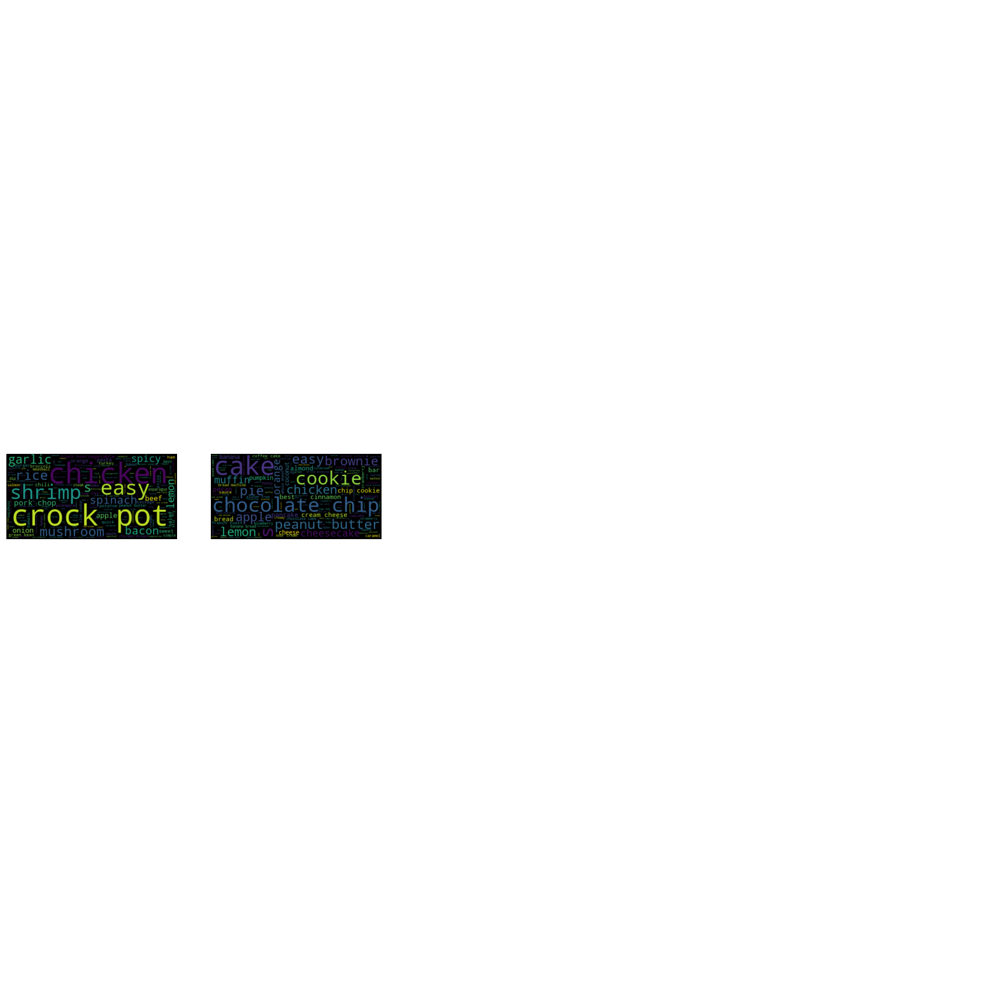

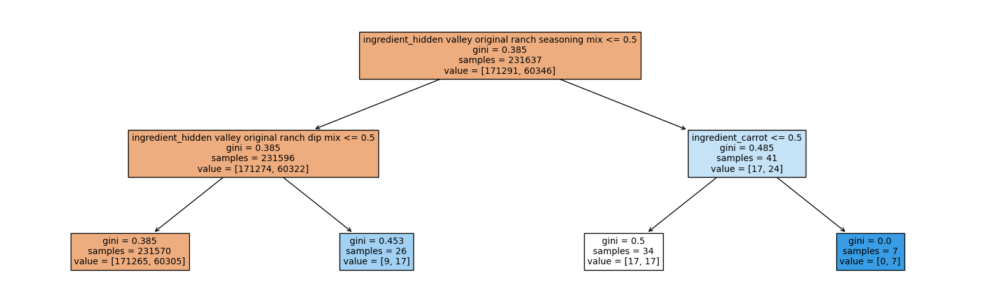

<Figure size 640x480 with 0 Axes>

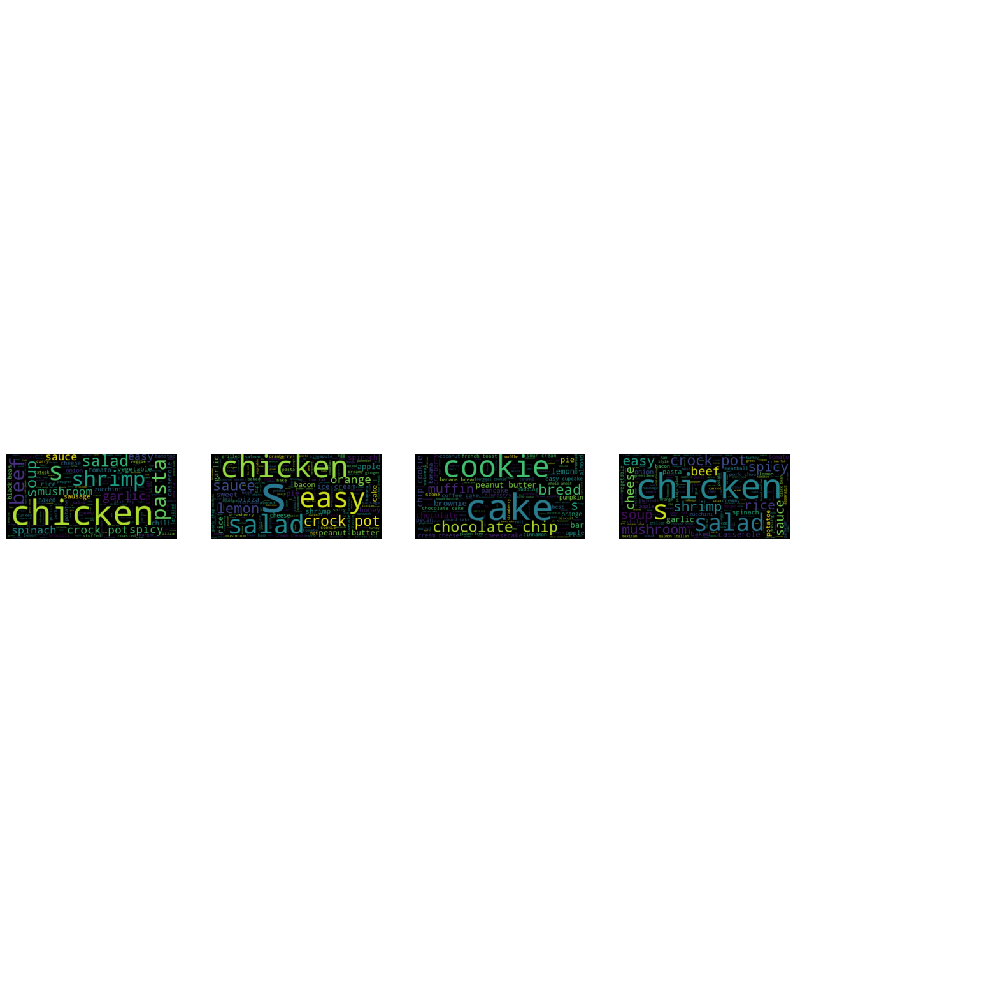

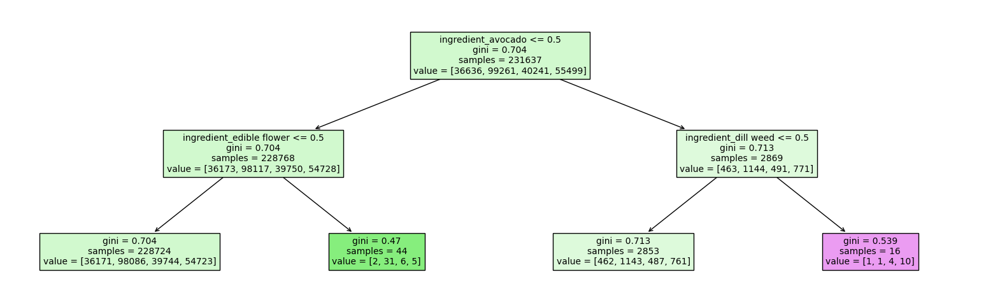

<Figure size 640x480 with 0 Axes>

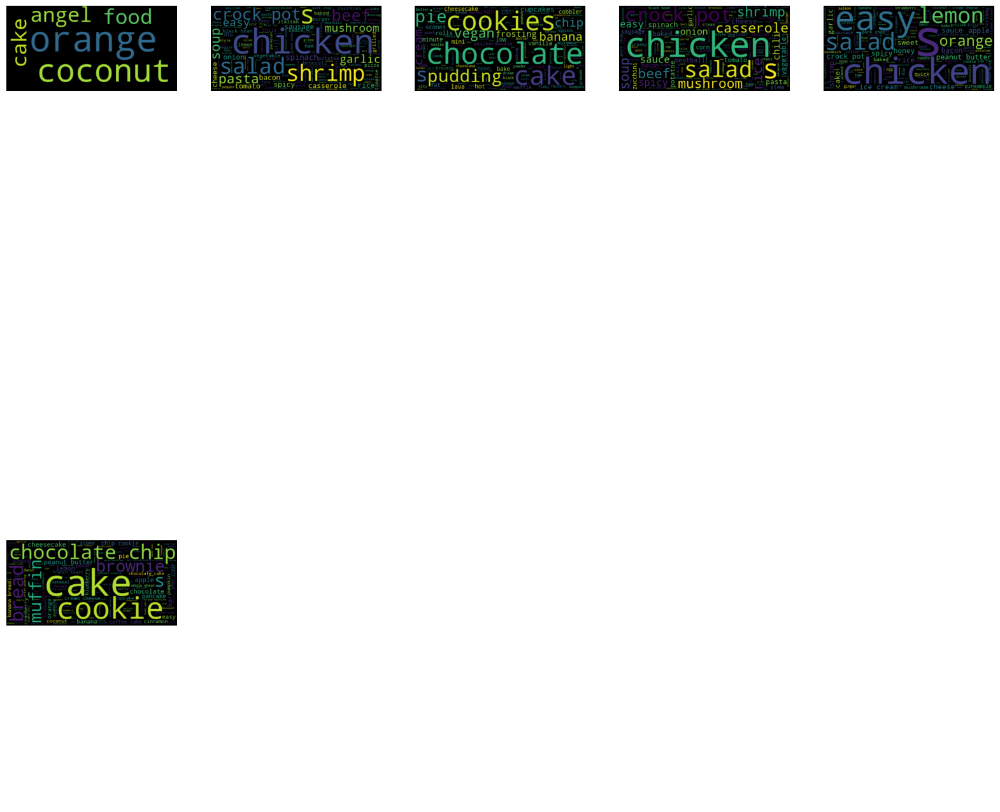

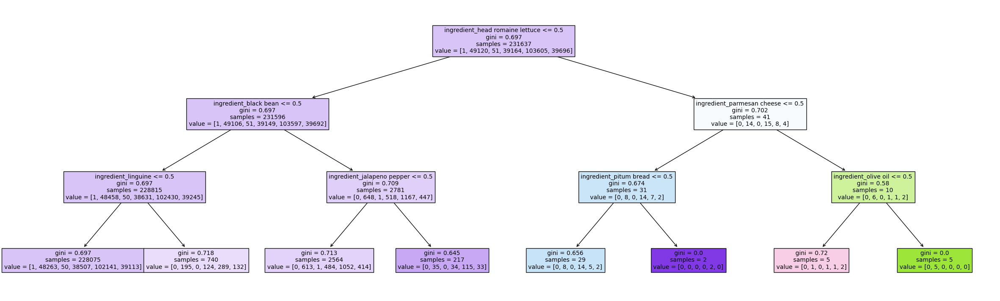

<Figure size 640x480 with 0 Axes>

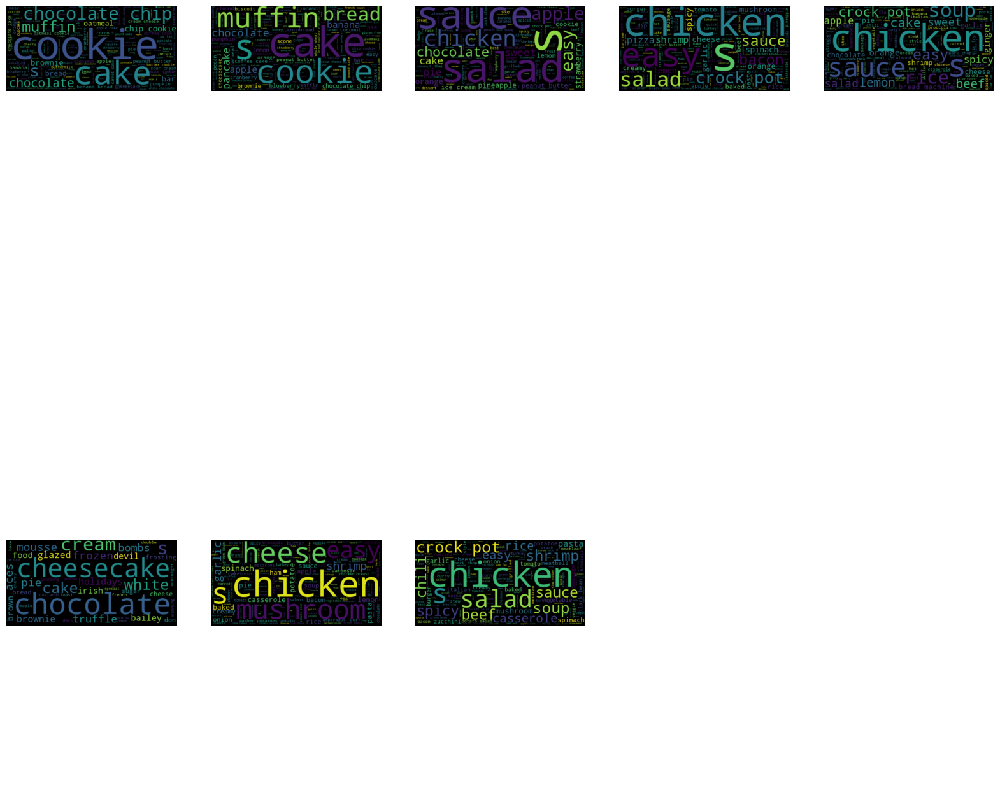

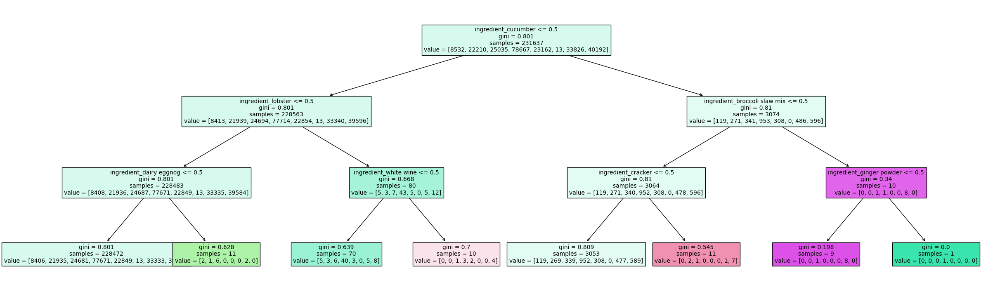

<Figure size 640x480 with 0 Axes>

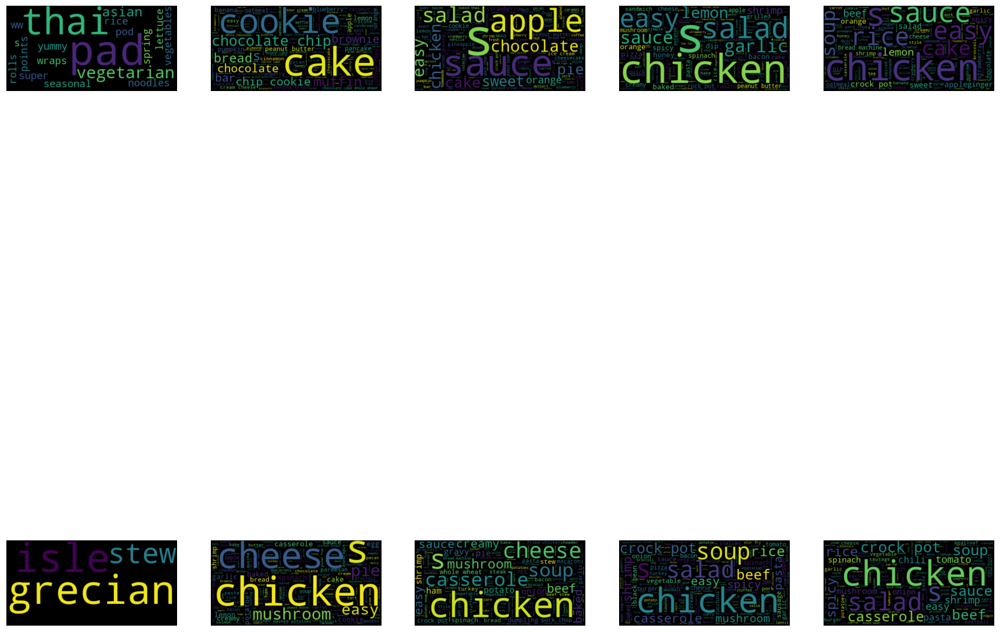

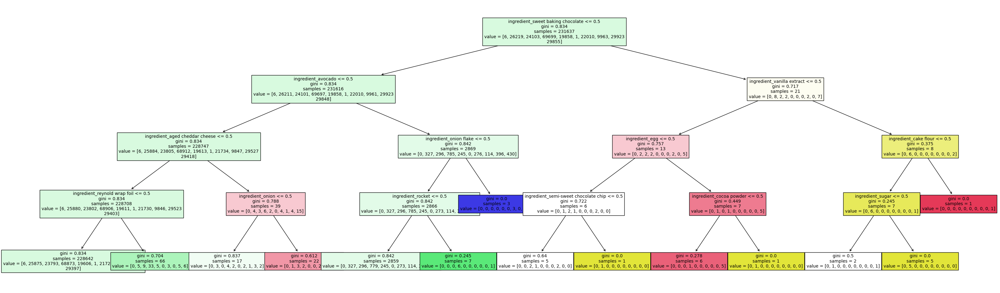

<Figure size 640x480 with 0 Axes>

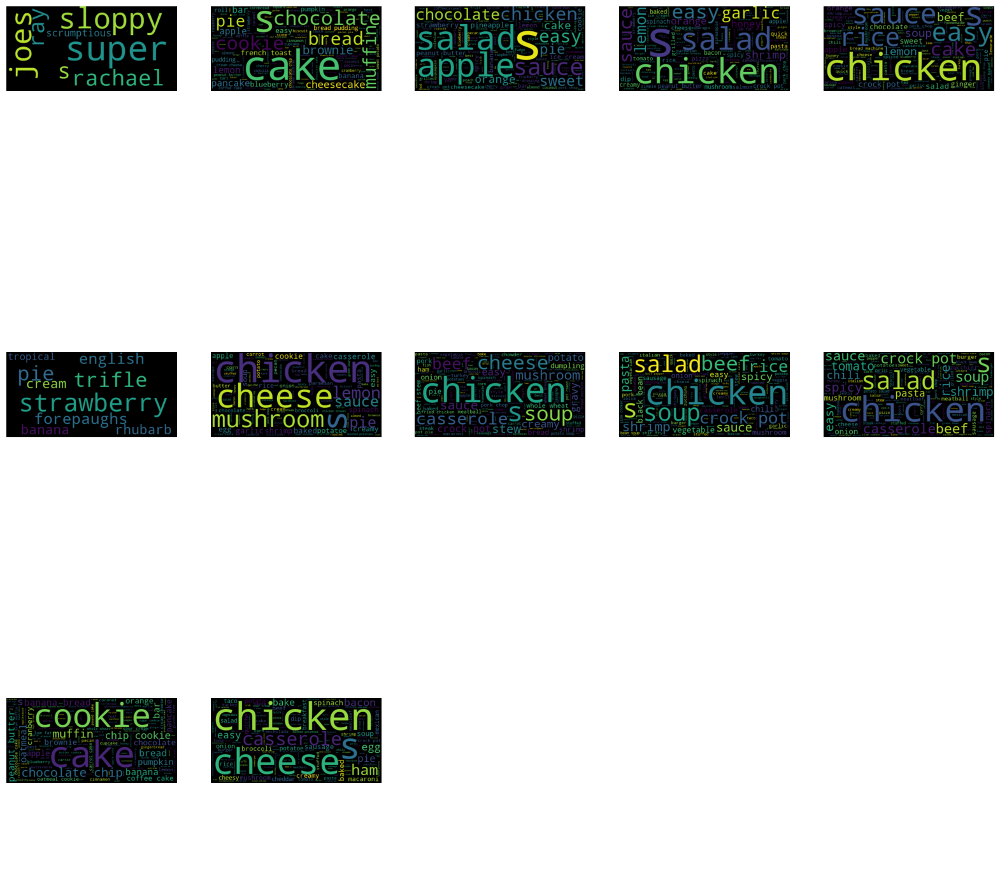

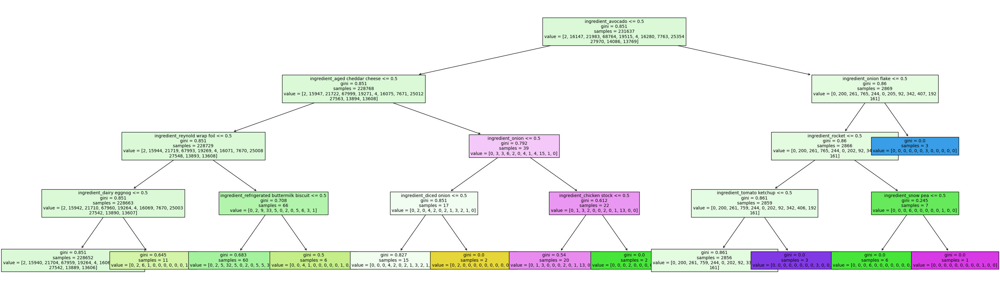

<Figure size 640x480 with 0 Axes>

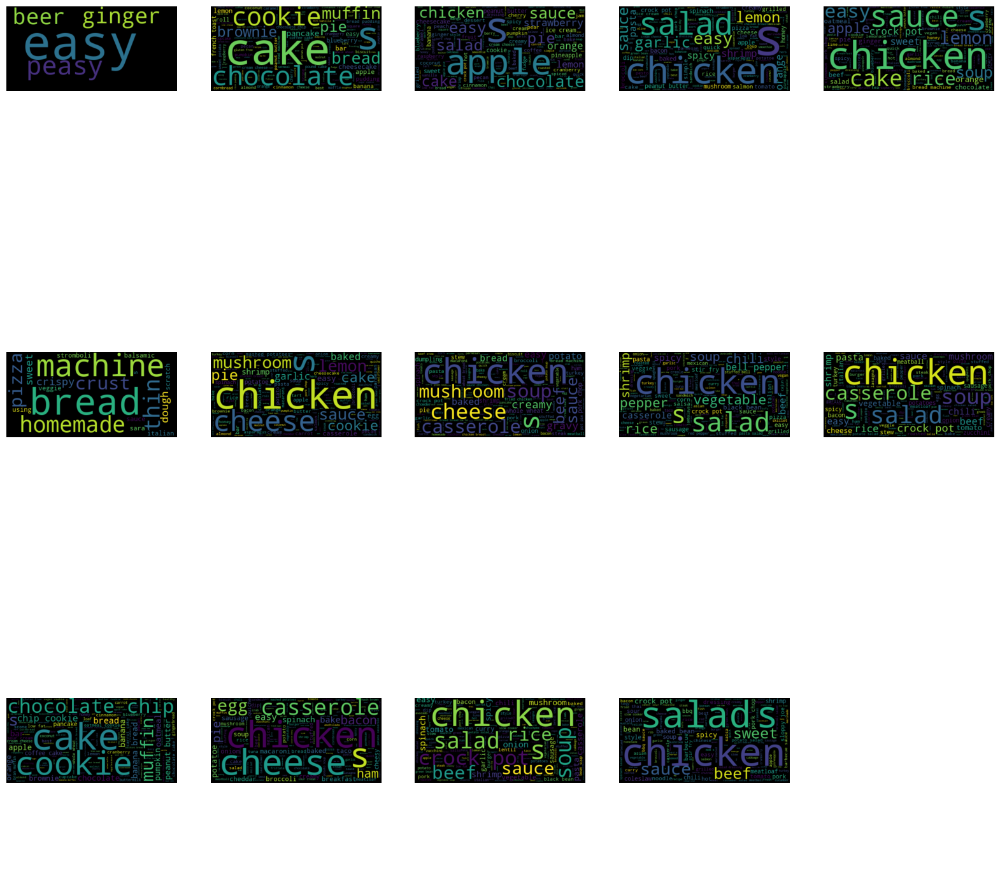

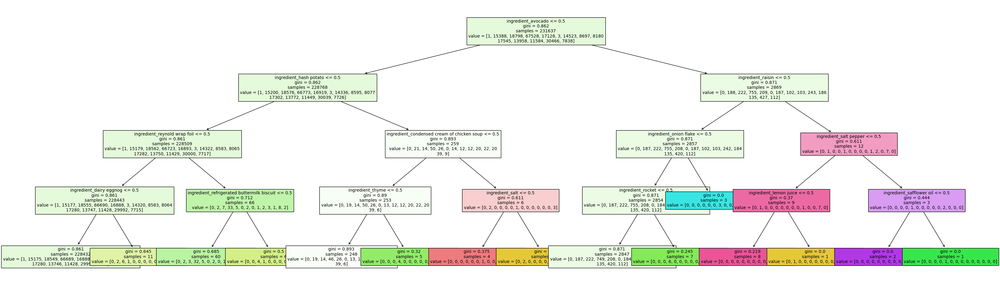

<Figure size 640x480 with 0 Axes>

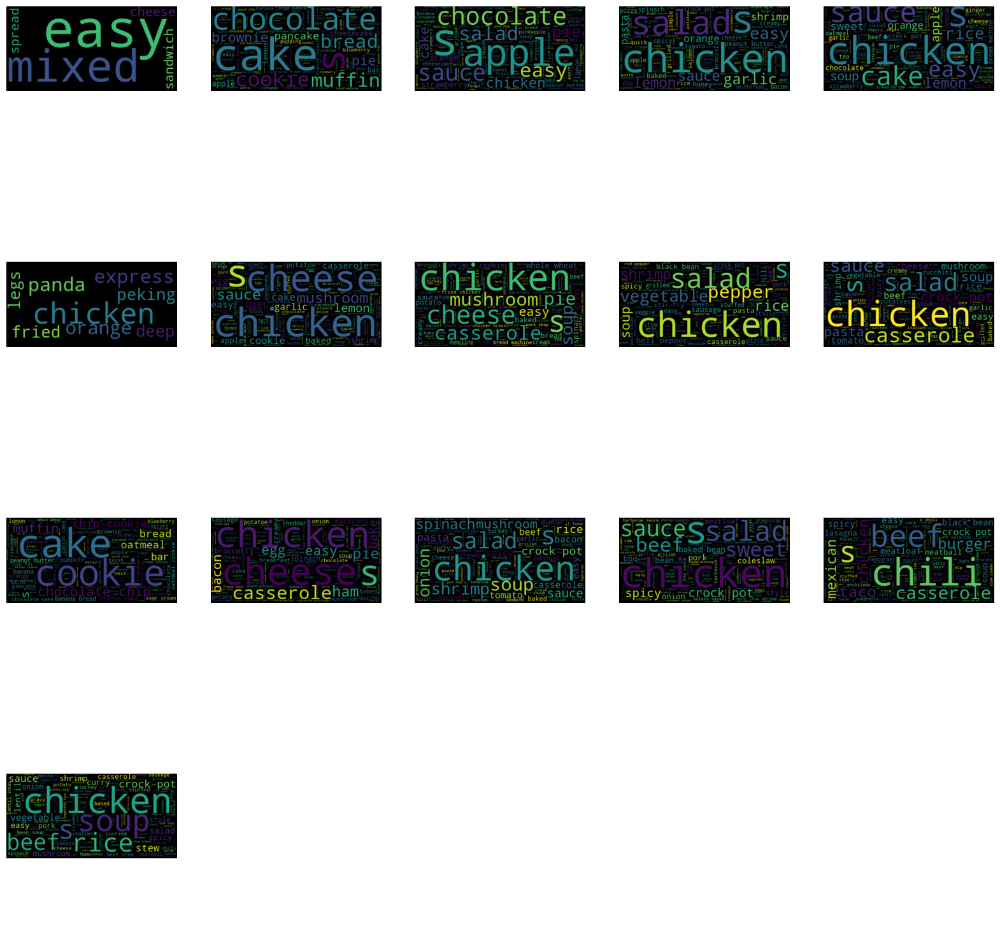

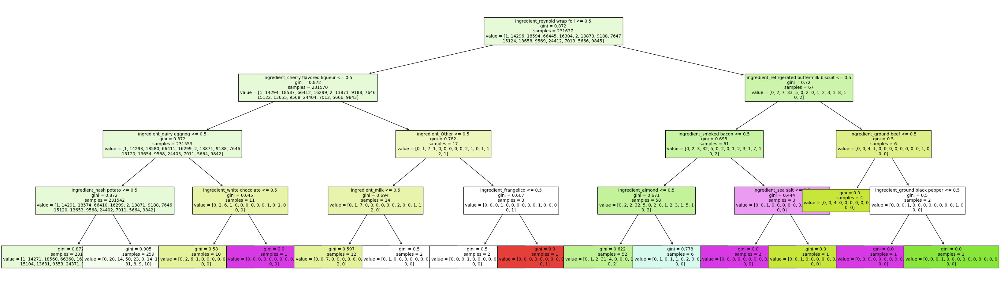

<Figure size 640x480 with 0 Axes>

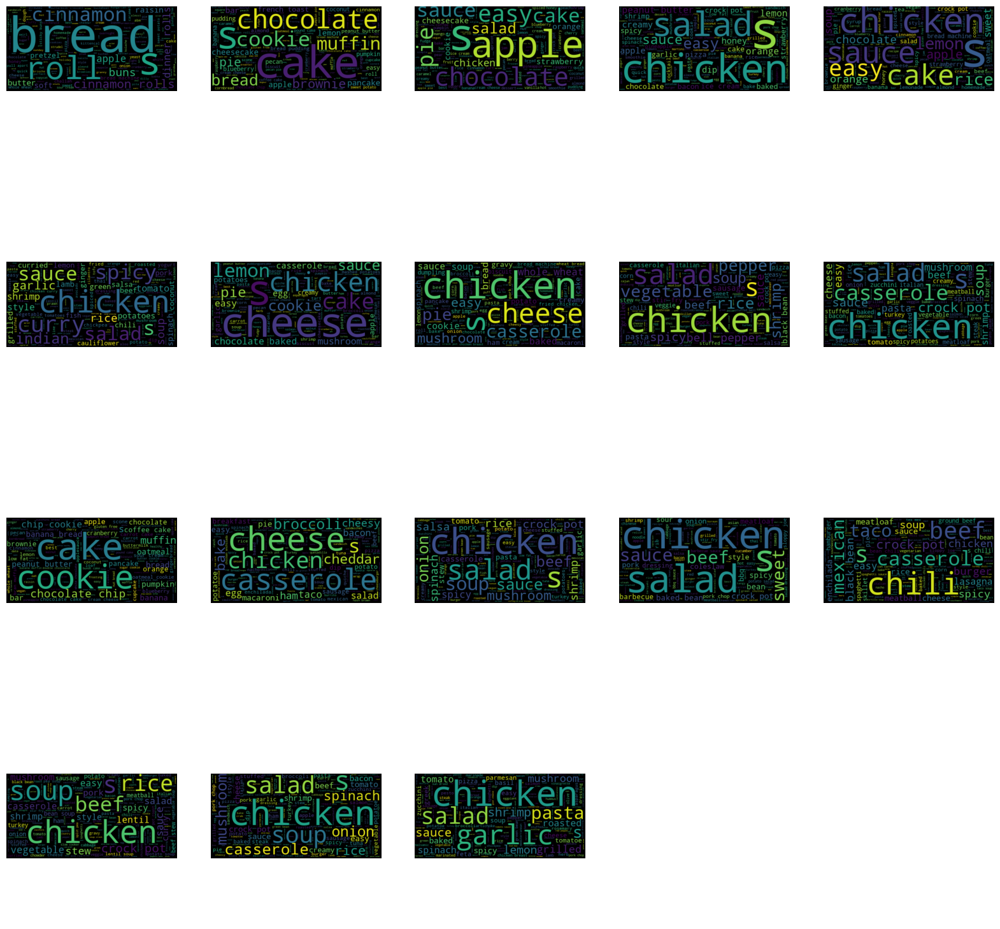

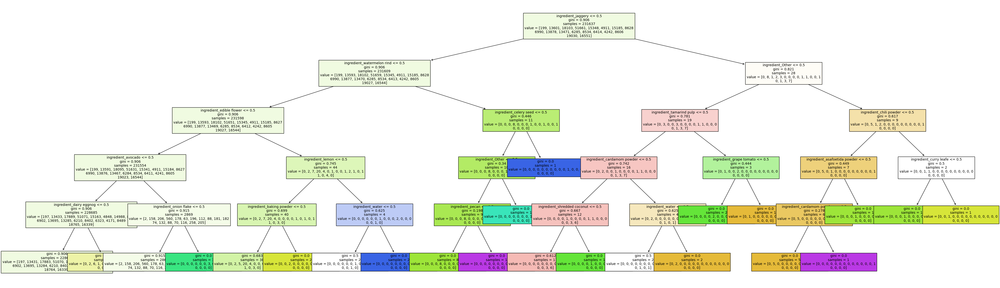

<Figure size 640x480 with 0 Axes>

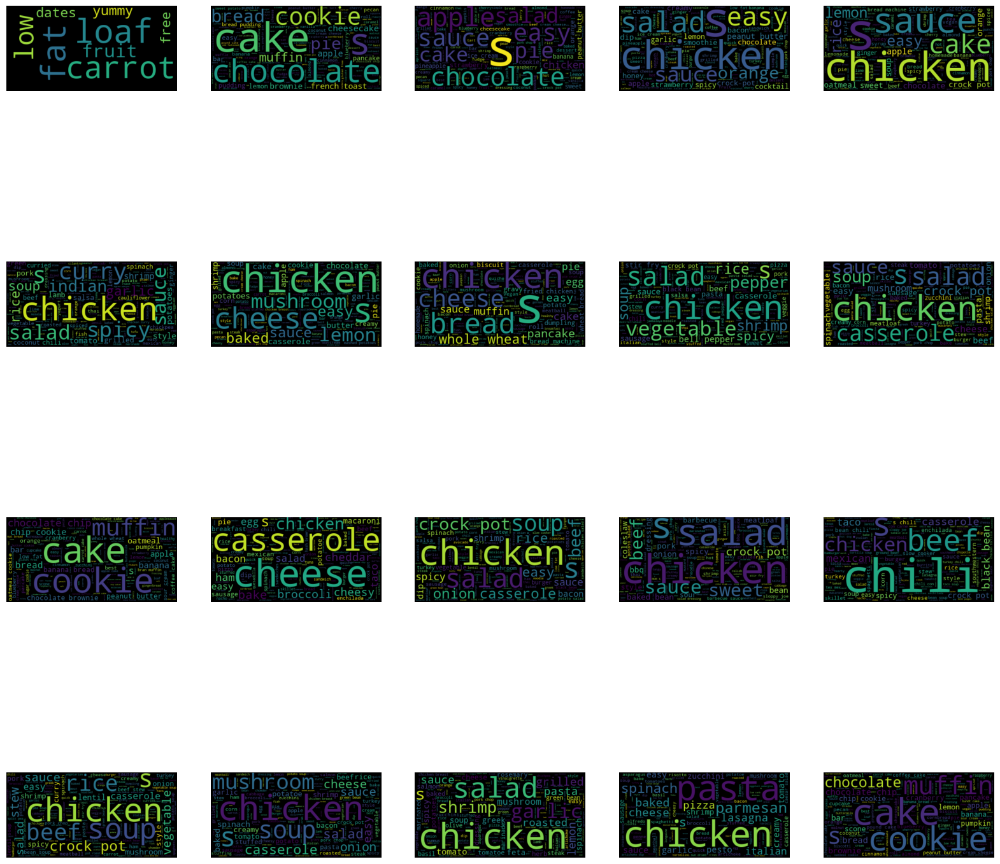

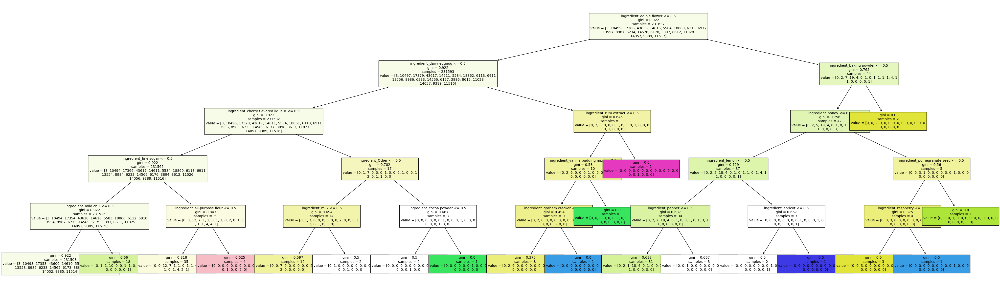

<Figure size 640x480 with 0 Axes>

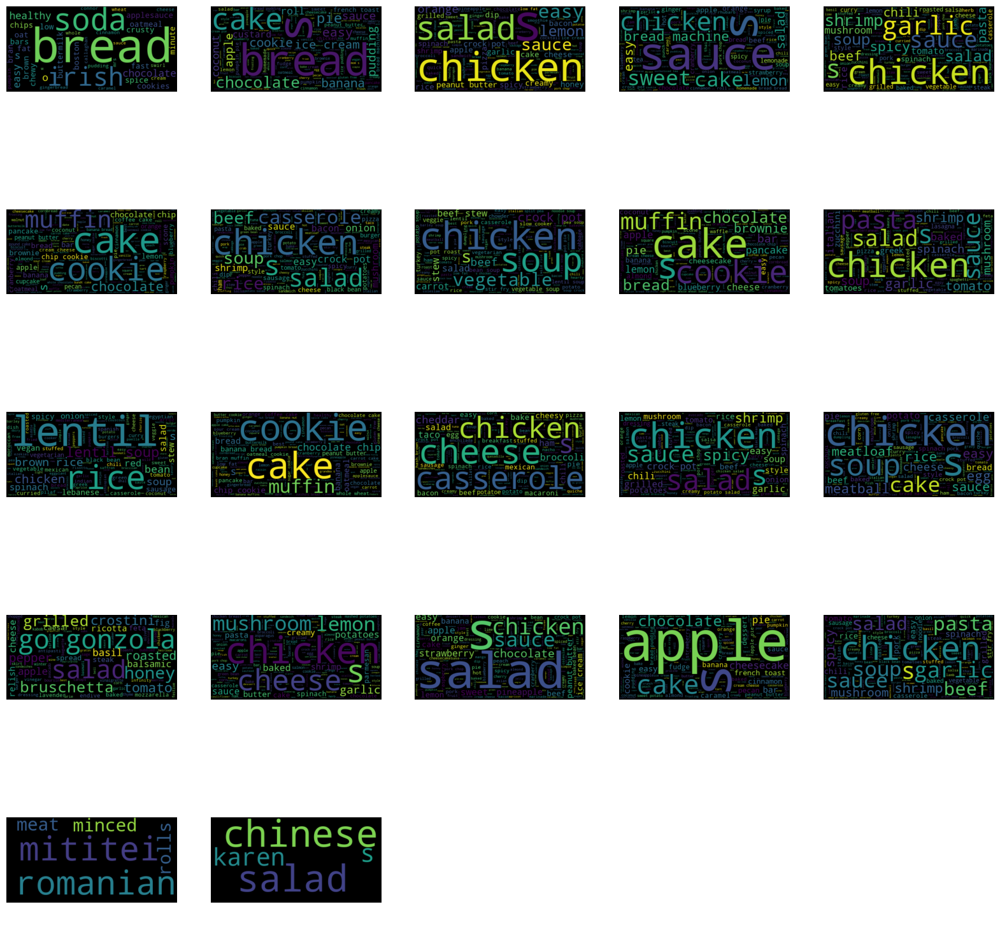

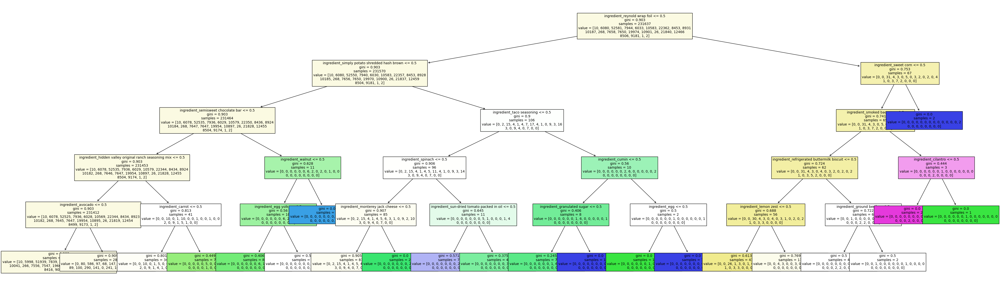

<Figure size 640x480 with 0 Axes>

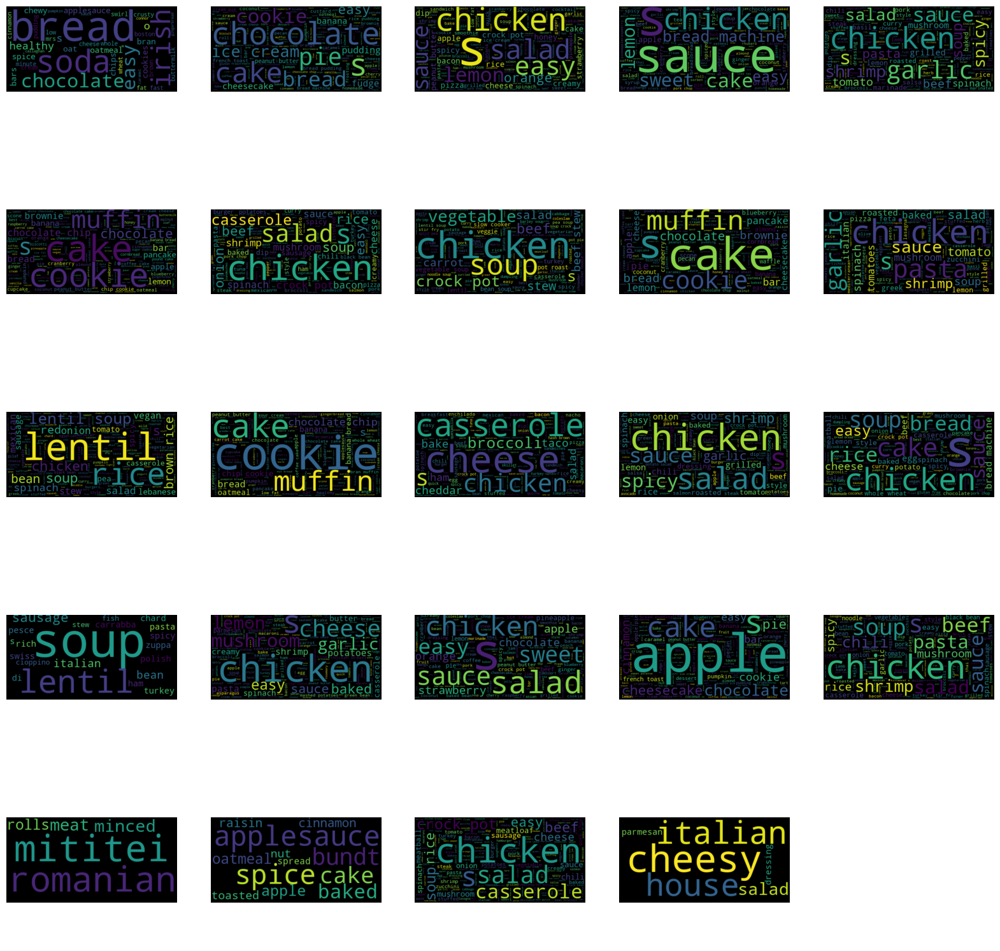

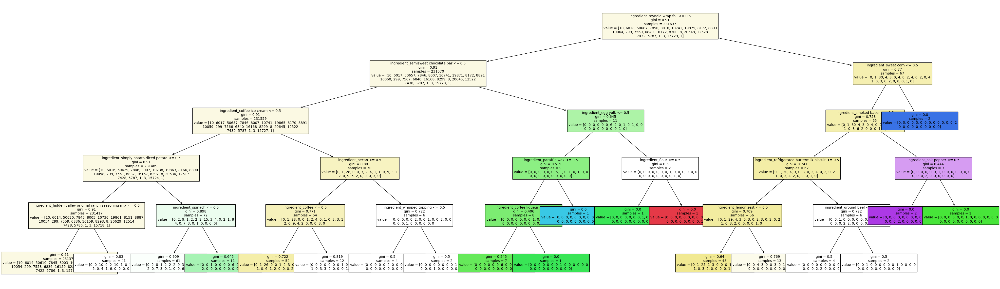

<Figure size 640x480 with 0 Axes>

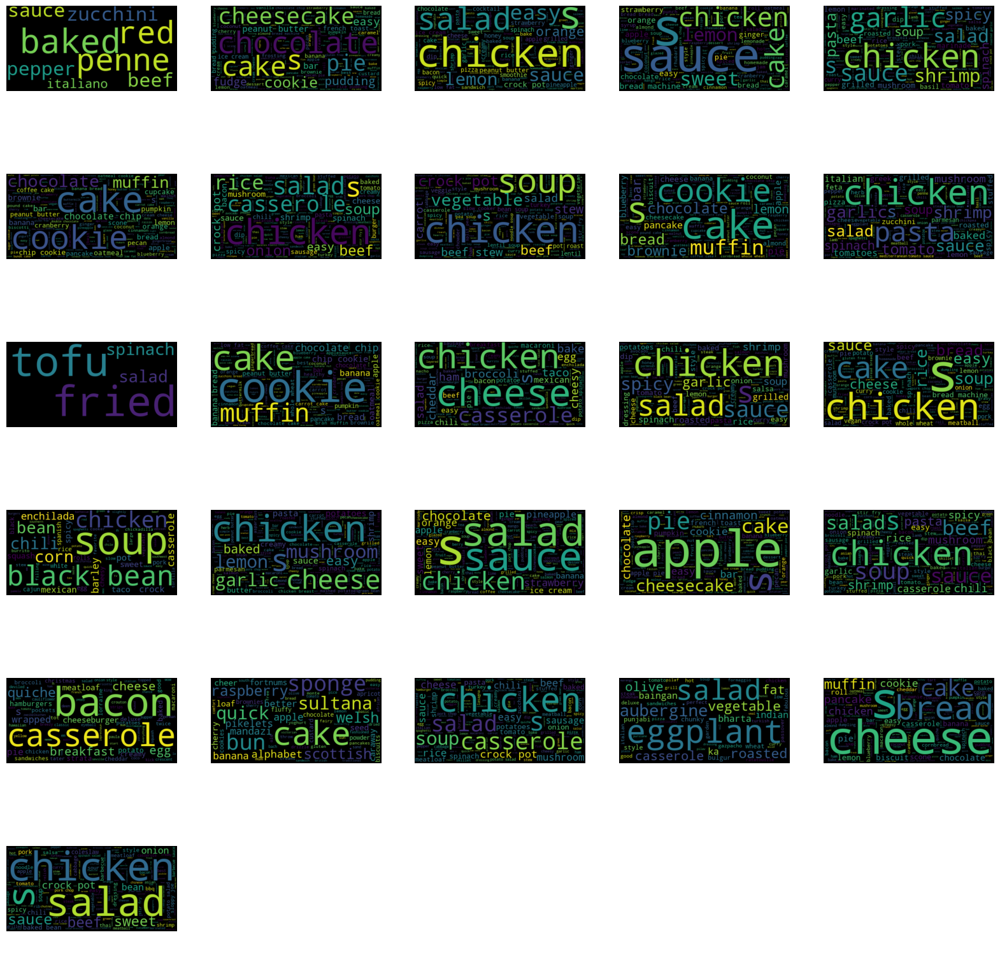

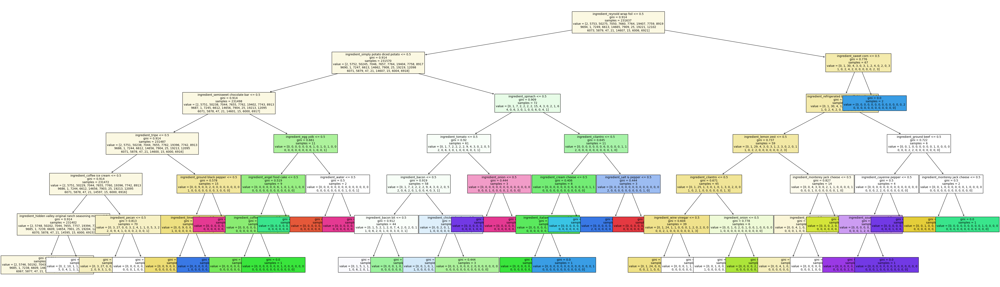

<Figure size 640x480 with 0 Axes>

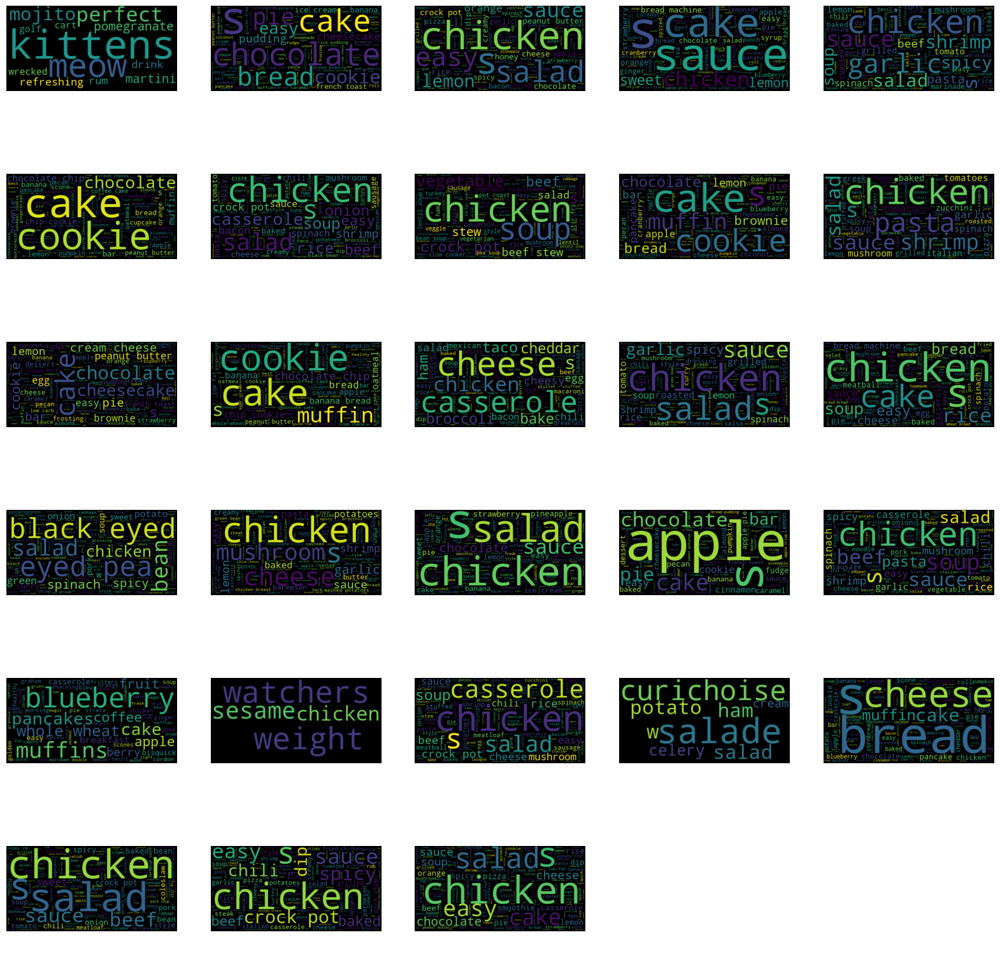

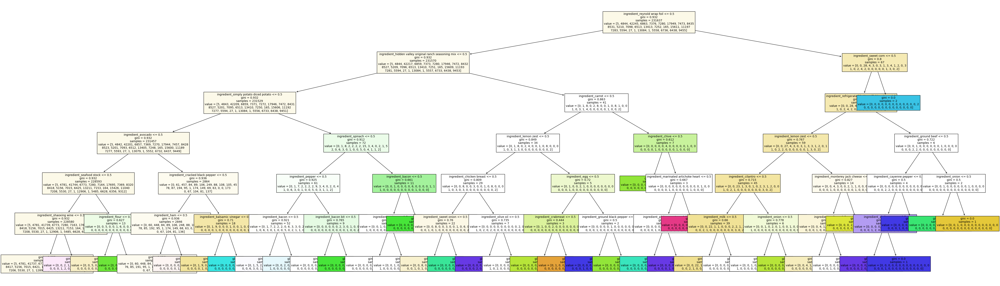

In [13]:
for idx, file in enumerate(model_locs): 
    labeled_recipes_df, labels = get_labeled_recipes(file)
    create_wordclouds(labeled_recipes_df, labels)
    create_tree(labeled_recipes_df, labels)